# Define some functions:

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from math import floor

# define functions to flatten and unflatten data

def flatten(df, run_tests=True):
  '''
  df is a numpy array with the following three axes:
    df.shape[0] = the index of a vertex
    df.shape[1] = the index of a time stamp
    df.shape[2] = the index of a dimension (x, y, z)
  
  So df[1][0][2] is the value for the 1st vertex (0-based) at time 0 in dimension 2 (z).
  
  To flatten this dataframe will mean to push the data into shape:
    flattened.shape[0] = time index
    flattened.shape[1] = [vertex_index*3] + dimension_vertex
    
  So flattened[1][3] will be the 3rd dimension of the 1st index (0-based) at time 1. 
  '''
  if run_tests:
    assert df.shape == X.shape and np.all(df == X)
  
  # reshape X such that flattened.shape = time, [x0, y0, z0, x1, y1, z1, ... xn-1, yn-1, zn-1]
  flattened = X.swapaxes(0, 1).reshape( (df.shape[1], df.shape[0] * df.shape[2]), order='C' )

  if run_tests: # switch to false to skip tests
    for idx, i in enumerate(df):
      for jdx, j in enumerate(df[idx]):
        for kdx, k in enumerate(df[idx][jdx]):
          assert flattened[jdx][ (idx*df.shape[2]) + kdx ] == df[idx][jdx][kdx]
          
  return flattened

def unflatten(df, run_tests=True, start_time_index=0):
  '''
  df is a numpy array with the following two axes:
    df.shape[0] = time index
    df.shape[1] = [vertex_index*3] + dimension_vertex
    
  To unflatten this dataframe will mean to push the data into shape:
    unflattened.shape[0] = the index of a vertex
    unflattened.shape[1] = the index of a time stamp
    unflattened.shape[2] = the index of a dimension (x, y, z)
    
  So df[2][4] == unflattened[1][2][0]
  '''
  if run_tests:
    assert (len(df.shape) == 2) and (df.shape[1] == X.shape[0] * X.shape[2])
  
  unflattened = np.zeros(( X.shape[0], df.shape[0], X.shape[2] ))

  for idx, i in enumerate(df):
    for jdx, j in enumerate(df[idx]):
      kdx = int(floor(jdx / 3))
      ldx = int(jdx % 3)
      unflattened[kdx][idx][ldx] = df[idx][jdx]

  if run_tests: # set to false to skip tests
    for idx, i in enumerate(unflattened):
      for jdx, j in enumerate(unflattened[idx]):
        for kdx, k in enumerate(unflattened[idx][jdx]):
          assert( unflattened[idx][jdx][kdx] == X[idx][int(start_time_index)+jdx][kdx] )

  return unflattened

In [3]:
import mpl_toolkits.mplot3d.axes3d as p3
from mpl_toolkits.mplot3d.art3d import juggle_axes
import matplotlib.pyplot as plt
from IPython.display import HTML
from matplotlib import animation
from copy import deepcopy
import matplotlib

# ask matplotlib to plot up to 2^128 frames in animations
matplotlib.rcParams['animation.embed_limit'] = 2**128

def update_points(time, points, df):
  '''
  Callback function called by plotting function below. Mutates the vertex
  positions of each value in `points` so the animation moves
  @param int time: the index of the time slice to visualize within `df`
  @param mpl_toolkits.mplot3d.art3d.Path3DCollection points: the actual
    geometry collection whose internal values this function mutates to move
    the displayed points
  @param numpy.ndarray df: a numpy array with the following three axes:
    df.shape[0] = n_vertices
    df.shape[1] = n_time_slices
    df.shape[2] = n_dimensions
  '''
  points._offsets3d = juggle_axes(df[:,time,0], df[:,time,1], df[:,time,2], 'z')

def get_plot(df, axis_min=0, axis_max=1, frames=200, speed=45, start_time_index=0, run_tests=True, c=None):
    '''
  General function that can plot numpy arrays in either of two shapes.
  @param numpy.ndarray df: a numpy array with either of the following two shapes:
    Possibility one:
      df.shape[0] = n_vertices
      df.shape[1] = n_time_slices
      df.shape[2] = n_dimensions
    Possibility two:
      df.shape[0] = n_time_slices
      df.shape[1] = [x0, y0, z0, x1, y1, z1, ... xn-1, yn-1, zn-1]
    If the latter is received, we "unflatten" the df into the three dimensional variant
  @param int axis_min: the minimum value of each axis scale
  @param int axis_max: the maximum value of each axis scale
  @param int frames: the number of time slices to animate.
  @param int speed: the temporal duration of each frame. Increase to boost fps.
  @param int start_time_index: the index position of the first frame in df within X. In other
    words, if df starts at the nth time frame from X, start_time_index = n.
  @param bool run_tests: boolean indicating whether we'll run the data validation
    tests, should we need to unflatten the array. Should be set to False if we're passing
    in predicted values, as they'll differ from X values.
    '''
    df = deepcopy(df)
    if len(df.shape) == 2:
        df = unflatten(df, start_time_index=start_time_index, run_tests=run_tests)
    # Center the whole dance in the (x,y) plane
    df[:,:,:2] -= df[:,:,:2].mean(axis=(0,1), keepdims=True)
  # plot the data
    fig = plt.figure()
    ax = p3.Axes3D(fig)
    ax.set_xlim(-1, 1)
    ax.set_ylim(-1, 1)
    ax.set_zlim(axis_min, axis_max*1.5)
    points = ax.scatter(df[:,0,0], df[:,0,1], df[:,0,2], depthshade=False, c=c) # x,y,z vals
    return animation.FuncAnimation(fig,
    update_points,
    frames,
    interval=speed,
    fargs=(points, df),
    blit=False  
#   ).to_jshtml() # works on Grace, but doesn't save easily
  ).to_html5_video() # doesn't work on Grace without ffmpeg, but does have a save button
#     ).save('pca_batch32.mp4')

In [4]:
# Set figure size
fig_size = plt.rcParams["figure.figsize"] 
print("Previous figure size:", fig_size) # Get current size
fig_size[0] = 10
fig_size[1] = 7
plt.rcParams["figure.figsize"] = fig_size # Set new figure width
print("Current figure size:", fig_size)
plt.rcParams.update({'font.size': 14})

Previous figure size: [6.0, 4.0]
Current figure size: [10, 7]


# Get dataset & visualize it:

In [5]:
from sklearn.datasets import fetch_mldata
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import train_test_split
import pandas as pd
from matplotlib import cm
import matplotlib.pyplot as plt 
from mpl_toolkits.mplot3d import Axes3D
import numpy as np

In [6]:
X = np.load('../data/npy/mariel_knownbetter.npy')
X = X*[1,1,-1] # flip the z-axis
n_joints, n_timeframes, n_dims = X.shape
print(X.shape) # (number of joints) X (number of time frames) X (x,y,z dimensions)
cavg = np.mean(X[:,:,2],axis=1)
cavg.shape

(55, 7649, 3)


(55,)

In [7]:
! ls ../generated_sequences/

pca_full_dimensions2019-02-28-21:19:54.npy
pca_full_dimensions2019-02-28-21:22:56.npy
pca_full_dimensions2019-02-28-22:04:27.npy
pca_full_dimensions2019-02-28-22:06:14.npy
pca_full_dimensions2019-02-28-22:08:15.npy
pca_full_dimensions2019-02-28-23:12:47.npy
pca_full_dimensions2019-03-01-20:57:25.npy
pca_full_dimensions.npy
pca_inverse_transform2019-02-28-21:19:54.npy
pca_inverse_transform2019-02-28-21:22:56.npy
pca_inverse_transform2019-02-28-22:04:27.npy
pca_inverse_transform2019-02-28-22:06:14.npy
pca_inverse_transform2019-02-28-22:08:15.npy
pca_inverse_transform2019-02-28-23:12:47.npy
pca_inverse_transform2019-03-01-20:57:25.npy
pca_inverse_transform.npy


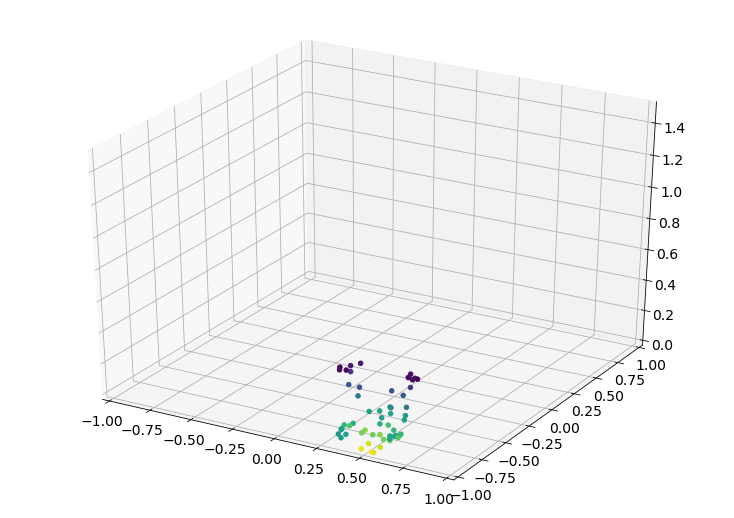

In [9]:
Y = np.load('../generated_sequences/pca_full_dimensions2019-02-28-23:12:47.npy')
HTML(get_plot(Y, frames=len(Y),run_tests=False,c=cavg))

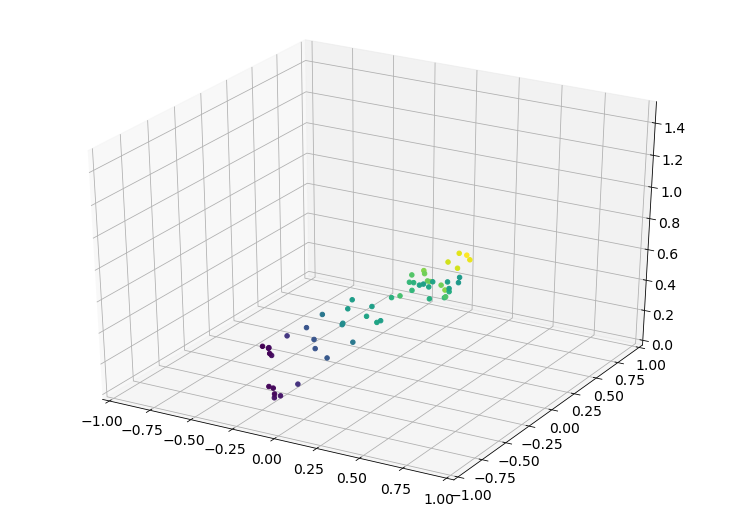

In [10]:
Y = np.load('../generated_sequences/pca_full_dimensions2019-03-01-20:57:25.npy')
HTML(get_plot(Y, frames=len(Y),run_tests=False,c=cavg))

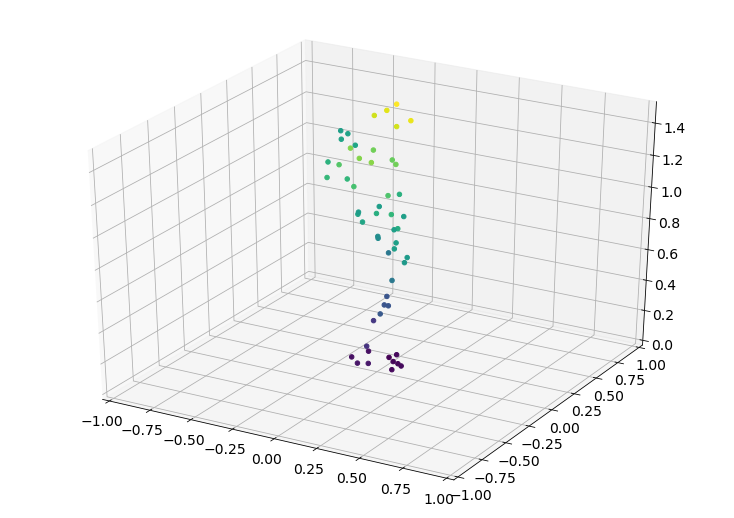

In [20]:
poses = df.loc[2500:3500,column_names]
poses = poses.values
HTML(get_plot(poses, frames=len(poses),run_tests=False,c=cavg))

# Prepare data
### Move each frame to (x,y)=(0,0), leaving the z dimension free

In [9]:
print(X.shape)
X[:,:,:2] -= X[:,:,:2].mean(axis=0, keepdims=True)

(55, 7649, 3)


### Then "flatten" dimensions, i.e. instead of n timestamps x 55 joints x 3 dimensions, use n timestamps x 165 joints

In [10]:
print(X.shape)
# reshape such that flattened.shape = time, [x0, y0, z0, x1, y1, z1, ... xn-1, yn-1, zn-1]
flat = X.swapaxes(0, 1).reshape( (X.shape[1], X.shape[0] * X.shape[2]), order='C' )
print(flat.shape)

(55, 7649, 3)
(7649, 165)


In [11]:
column_names = [ 'joint'+str(i)+'_'+str(j) for i in range(int(flat.shape[1]/3)) for j in ['x','y','z']]
df = pd.DataFrame(flat, columns=column_names)
df = df[500:-500] # chop off the beginning and end to avoid static frames
print('Size of the dataframe: {}'.format(df.shape))

Size of the dataframe: (6649, 165)


In [14]:
random_permutation = np.random.permutation(df.shape[0])
# random_permutation

# First, we'll use PCA:

Explained variation per principal component: [0.51560502 0.13133606]


Text(0, 0.5, 'PCA-1')

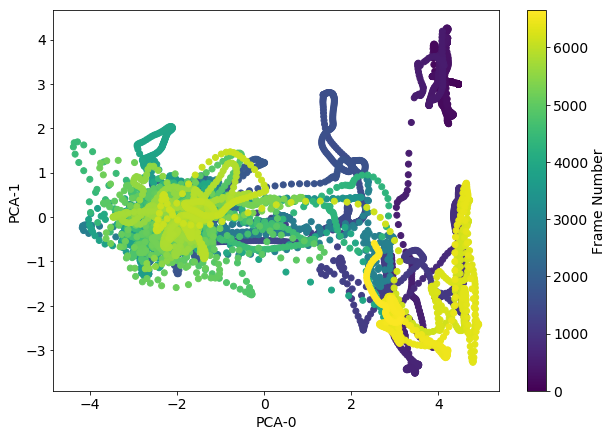

In [15]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2) # can either do this by num of desired components...
# pca = PCA(.95) # ...or by percentage variance you want explained 

pca_columns=[]

pca_result = pca.fit_transform(df.values)
for i in range(pca_result.shape[1]):
    df['pca_'+str(i)] = pca_result[:,i]
    pca_columns.append('pca_'+str(i))
    
print('Explained variation per principal component: {}'.format(pca.explained_variance_ratio_))

# Plot just the first two dimensions in PCA space
plt.scatter(df.loc[:,"pca_0"],df.loc[:,"pca_1"],c=np.arange(len(df)),cmap='viridis')
plt.colorbar(label="Frame Number")

plt.xlabel("PCA-0")
plt.ylabel("PCA-1")

In [17]:
# Get the transformed dataset 
print(df[pca_columns].shape)
# df[pca_columns]

(6649, 2)


Training then happens here, on the reduced-dimensionality dataset. 

Then, just for practice, let's try reversing this process and reconstructing original coordinates from the compressed coordinates:

In [15]:
print("Compressed shape", df[pca_columns].shape)
reconstructed_data=np.dot(df[pca_columns], pca.components_)
print("Reconstructed shape", reconstructed_data.shape)

Compressed shape (7757, 2)
Reconstructed shape (7757, 165)


Now plot an example of a compressed shape and a reconstructed shape:

---

# Compare poses from two nearly-overlapping points in this phase space:

Pick a random point:

In [16]:
pose1_index = np.random.choice(len(df))
print(pose1_index)

4456


Find the closest point to this point in the compressed dataset that isn't the original point: 

In [17]:
# Calculate each frame's distance from pose1 in the compressed space
distance=[]
for i in range(len(df)):
    distance.append(np.linalg.norm(df.loc[pose1_index,pca_columns] - df.loc[i,pca_columns]))

# Add a column to the dataframe with this distance
df["distance"]=distance

In [18]:
# look at points that have very small distances but aren't near the original sequence
df.loc[df["distance"]<.3]

,joint0_x,joint0_y,joint0_z,joint1_x,joint1_y,joint1_z,joint2_x,joint2_y,joint2_z,joint3_x,...,joint52_z,joint53_x,joint53_y,joint53_z,joint54_x,joint54_y,joint54_z,pca_0,pca_1,distance
313,-0.050286,0.092499,1.587684,-0.087109,0.096323,1.341788,-0.079982,-0.088638,1.301446,0.038127,...,1.080653,-0.029500,0.025298,0.832153,-0.072505,0.125343,1.161629,0.044558,1.102936,0.281623
314,-0.042802,0.099890,1.580097,-0.082276,0.104671,1.339975,-0.086070,-0.079755,1.295495,0.039869,...,1.074919,-0.024933,0.036801,0.830522,-0.064193,0.137004,1.160571,-0.015177,1.162190,0.197502
315,-0.036190,0.105015,1.567160,-0.075607,0.110895,1.332248,-0.087676,-0.072146,1.283651,0.047137,...,1.063746,-0.015647,0.045462,0.823838,-0.053238,0.147564,1.154110,-0.041539,1.206665,0.147632
316,-0.031002,0.106325,1.553605,-0.068880,0.112474,1.321196,-0.085803,-0.068979,1.269366,0.058773,...,1.050433,-0.004648,0.049939,0.814220,-0.043332,0.151896,1.144100,-0.027632,1.237297,0.141397
317,-0.025803,0.103207,1.543071,-0.061901,0.108788,1.312591,-0.081904,-0.071190,1.258491,0.068822,...,1.041010,0.003281,0.046246,0.804784,-0.033770,0.150398,1.136290,0.005993,1.261853,0.163638
318,-0.019370,0.096561,1.538648,-0.053554,0.102090,1.307684,-0.077956,-0.077902,1.255752,0.073365,...,1.038145,0.008395,0.035582,0.799812,-0.024593,0.141200,1.131070,0.031508,1.280651,0.185016
319,-0.013011,0.090944,1.542596,-0.046880,0.094797,1.311090,-0.079322,-0.084525,1.261686,0.073244,...,1.042916,0.007708,0.024658,0.802353,-0.018380,0.131158,1.133988,0.029849,1.297777,0.181921
320,-0.005593,0.085817,1.549532,-0.037867,0.089574,1.320065,-0.083987,-0.086538,1.270487,0.077016,...,1.051744,0.008636,0.013754,0.810684,-0.009151,0.122852,1.142236,0.007942,1.282441,0.161423
321,0.001264,0.081881,1.558123,-0.027011,0.084943,1.332198,-0.094694,-0.083088,1.280750,0.081769,...,1.060590,0.014615,0.007547,0.823506,0.004383,0.116438,1.154475,-0.032440,1.248868,0.131892
322,0.005997,0.079858,1.568059,-0.015927,0.079692,1.347265,-0.106376,-0.075515,1.291392,0.082748,...,1.071639,0.016787,0.007152,0.837469,0.020941,0.110710,1.170470,-0.086787,1.193674,0.128712


Choose one that isn't near pose_1 in time:

In [19]:
pose2_index = 1242

Now plot them as static poses:

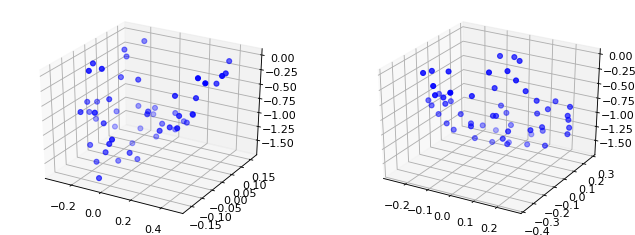

In [20]:
pose1 = df.loc[pose1_index]
pose2 = df.loc[pose2_index]

fig = plt.figure(num=None, figsize=(10, 8), dpi=80)

ax_1 = fig.add_subplot(221, projection='3d')
xs_1 = pose1.loc[column_names][0::3]
ys_1 = pose1.loc[column_names][1::3]
zs_1 = pose1.loc[column_names][2::3]
ax_1.scatter(xs_1, ys_1, -zs_1, marker='o', c='blue')

ax_2 = fig.add_subplot(222, projection='3d')
xs_2 = pose2.loc[column_names][0::3]
ys_2 = pose2.loc[column_names][1::3]
zs_2 = pose2.loc[column_names][2::3]
ax_2.scatter(xs_2, ys_2, -zs_2, marker='o', c='blue')

...and as sequences:

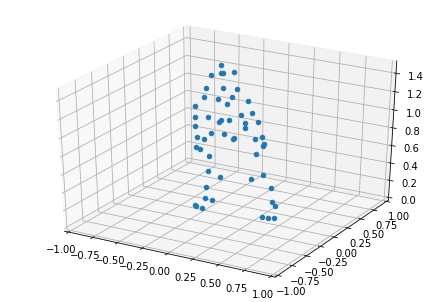

In [26]:
poses1 = df.loc[pose1_index:pose1_index+5,column_names]
poses2 = df.loc[pose2_index:pose2_index+5,column_names]
poses1_np = poses1.values
poses2_np = poses2.values

HTML(get_plot(poses1_np, frames=len(poses1_np),run_tests=False))

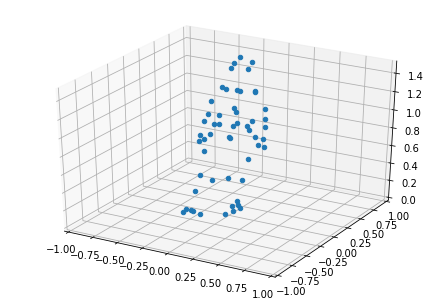

In [27]:
HTML(get_plot(poses2_np, frames=len(poses2_np),run_tests=False))

### Interpolate on a line in PCA space

Pick two endpoints for the line in (pca_0, pca_1) coordinates:

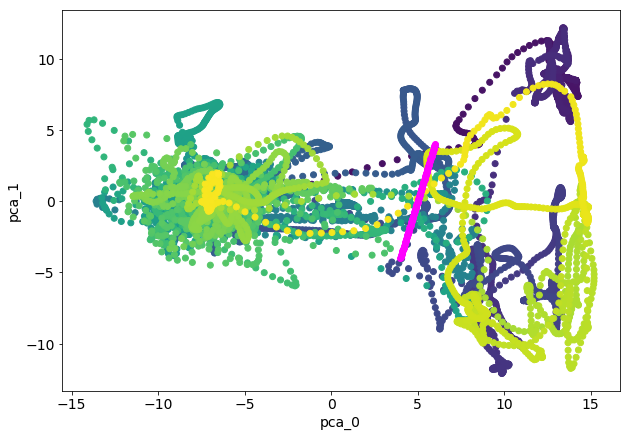

In [28]:
line_start = (4,-4)
line_end = (6,4)

interp_x = np.linspace(line_start[0],line_end[0],100)
interp_y = np.interp(interp_x, [line_start[0],line_end[0]], [line_start[1],line_end[1]])

plt.scatter(df.loc[:,"pca_0"],df.loc[:,"pca_1"],c=np.arange(len(df)),cmap='viridis')
plt.xlabel("pca_0")
plt.ylabel("pca_1")
plt.scatter(interp_x,interp_y,color='magenta')
plt.show()

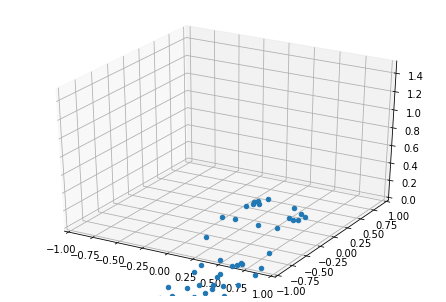

In [29]:
interp = np.vstack((interp_x,interp_y)).T
pca_interp=np.dot(interp, pca.components_)
pca_interp[:,:165].shape # only use 55*3 variables, i.e. actual joints instead of PCA scores

HTML(get_plot(pca_interp[:,:165], frames=len(pca_interp),run_tests=False))

### Get fancier in interpolations

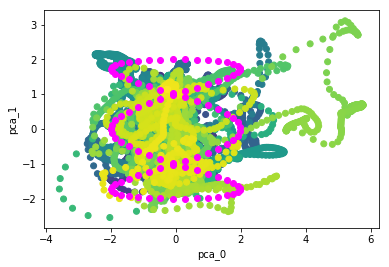

In [30]:
stroke_x = 2*np.cos(3*np.linspace(-np.pi,np.pi,100))
stroke_y = 2*np.sin(np.linspace(-np.pi,np.pi,100))

plt.scatter(df.loc[:,"pca_0"],df.loc[:,"pca_1"],c=np.arange(len(df)),cmap='viridis')
plt.xlabel("pca_0")
plt.ylabel("pca_1")
plt.scatter(stroke_x,stroke_y,color='magenta')
plt.show()

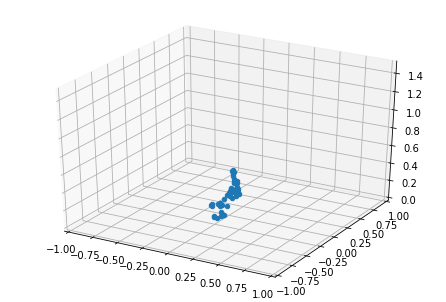

In [31]:
stroke = np.vstack((stroke_x,stroke_y)).T
pca_stroke=np.dot(stroke, pca.components_)
pca_stroke[:,:165].shape # only use 55*3 variables, i.e. actual joints instead of PCA scores

HTML(get_plot(pca_stroke[:,:165], frames=len(pca_stroke),run_tests=False))

## Highlight a particular real sequence of data for illustration

In [49]:
frame_start = 1750 
seq_length = 50

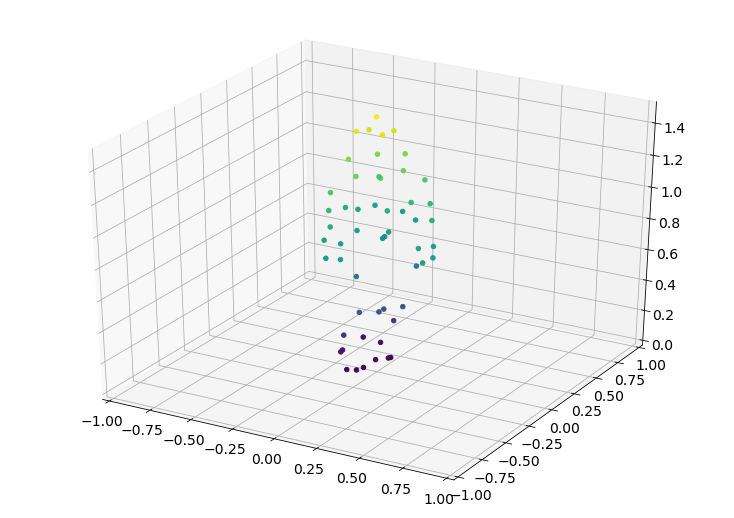

In [50]:
poses = df.loc[frame_start:frame_start+seq_length,column_names]
poses_np = poses.values
HTML(get_plot(poses_np, frames=len(poses_np),run_tests=False,c=cavg))

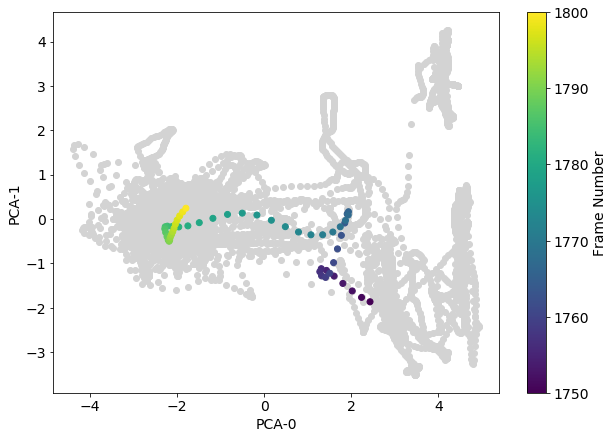

In [51]:
plt.scatter(df.loc[:,"pca_0"],df.loc[:,"pca_1"],color='lightgrey')
plt.scatter(df.loc[frame_start:frame_start+seq_length,"pca_0"],df.loc[frame_start:frame_start+seq_length,"pca_1"],c=np.arange(frame_start,frame_start+seq_length+1),cmap='viridis')
plt.colorbar(label="Frame Number")
plt.xlabel("PCA-0")
plt.ylabel("PCA-1")
plt.show()

# Next, try t-SNE:

In [52]:
import time
from sklearn.manifold import TSNE

time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=600)
tsne_results = tsne.fit_transform(df) 

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 6649 samples in 0.072s...
[t-SNE] Computed neighbors for 6649 samples in 6.055s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6649
[t-SNE] Computed conditional probabilities for sample 2000 / 6649
[t-SNE] Computed conditional probabilities for sample 3000 / 6649
[t-SNE] Computed conditional probabilities for sample 4000 / 6649
[t-SNE] Computed conditional probabilities for sample 5000 / 6649
[t-SNE] Computed conditional probabilities for sample 6000 / 6649
[t-SNE] Computed conditional probabilities for sample 6649 / 6649
[t-SNE] Mean sigma: 0.129501
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.366951
[t-SNE] KL divergence after 600 iterations: 0.717872
t-SNE done! Time elapsed: 38.74871563911438 seconds


Text(0, 0.5, 'TSNE-1')

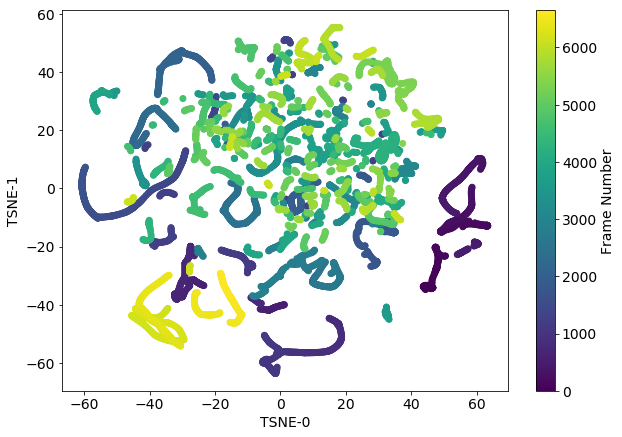

In [53]:
df_tsne = df.copy()
df_tsne['x-tsne'] = tsne_results[:,0]
df_tsne['y-tsne'] = tsne_results[:,1]

colors = np.arange(len(df_tsne))
plt.scatter(df_tsne["x-tsne"], df_tsne["y-tsne"],c=colors,cmap='viridis')
plt.colorbar(label="Frame Number")
plt.xlabel("TSNE-0")
plt.ylabel("TSNE-1")

## Visualize results

Text(0, 0.5, 'TSNE-1')

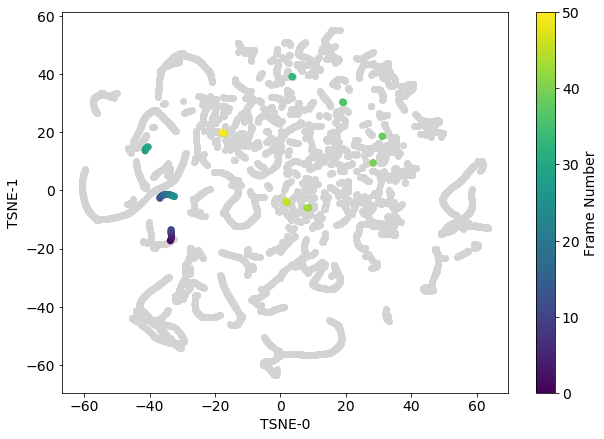

In [54]:
plt.scatter(df_tsne["x-tsne"], df_tsne["y-tsne"],color='lightgrey')
plt.scatter(df_tsne.loc[frame_start:frame_start+seq_length,"x-tsne"], df_tsne.loc[frame_start:frame_start+seq_length,"y-tsne"], c=np.arange(seq_length+1), cmap='viridis')
plt.colorbar(label="Frame Number")
plt.xlabel("TSNE-0")
plt.ylabel("TSNE-1")

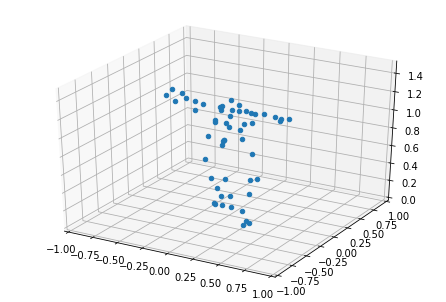

In [202]:
# pick out a short sequence following the first pose 
poses1 = df_tsne.loc[pose1_index:pose1_index+seq_length-1,column_names]

# poses1 = df_tsne.loc[random_permutation[list(random_permutation).index(pose1_index)]:random_permutation[list(random_permutation).index(pose1_index)+50],column_names]
poses1_np = poses1.values
HTML(get_plot(poses1_np, frames=len(poses1_np), run_tests=False))

# Now try t-SNE after dimensionality reduction from PCA:

In [55]:
pca_2 = PCA(n_components=2)
pca_result_2 = pca_2.fit_transform(df.values)
print('Cumulative explained variation : {}'.format(np.sum(pca_2.explained_variance_ratio_)))

Cumulative explained variation : 0.7856274744110939


In [56]:
time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=600)
tsne_pca_results = tsne.fit_transform(pca_result_2)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 6649 samples in 0.002s...
[t-SNE] Computed neighbors for 6649 samples in 0.149s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6649
[t-SNE] Computed conditional probabilities for sample 2000 / 6649
[t-SNE] Computed conditional probabilities for sample 3000 / 6649
[t-SNE] Computed conditional probabilities for sample 4000 / 6649
[t-SNE] Computed conditional probabilities for sample 5000 / 6649
[t-SNE] Computed conditional probabilities for sample 6000 / 6649
[t-SNE] Computed conditional probabilities for sample 6649 / 6649
[t-SNE] Mean sigma: 0.028419
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.015724
[t-SNE] KL divergence after 600 iterations: 0.628100
t-SNE done! Time elapsed: 34.35447406768799 seconds


Text(0, 0.5, 'TSNE-PCA-1')

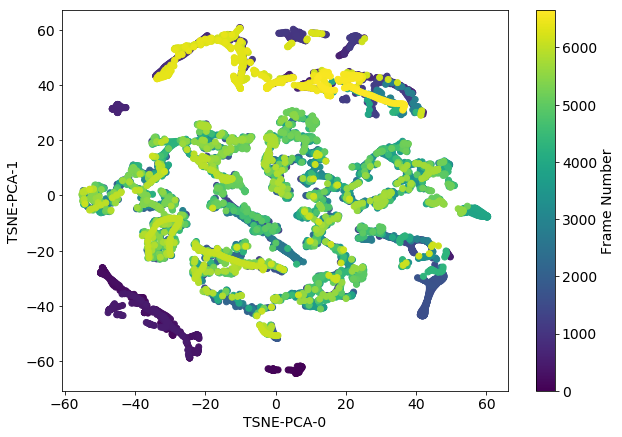

In [57]:
df_tsne['x-tsne-pca'] = tsne_pca_results[:,0]
df_tsne['y-tsne-pca'] = tsne_pca_results[:,1]

plt.scatter(df_tsne["x-tsne-pca"], df_tsne["y-tsne-pca"],c=colors,cmap='viridis')
plt.colorbar(label="Frame Number")
plt.xlabel("TSNE-PCA-0")
plt.ylabel("TSNE-PCA-1")

### Visualize results

Text(0, 0.5, 'TSNE-PCA-1')

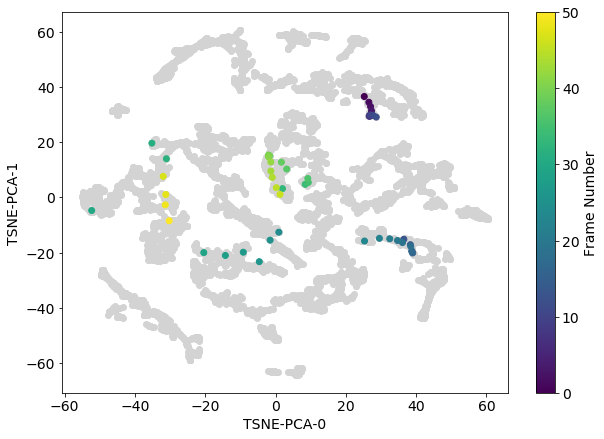

In [58]:
plt.scatter(df_tsne["x-tsne-pca"], df_tsne["y-tsne-pca"],color='lightgrey')
plt.scatter(df_tsne.loc[frame_start:frame_start+seq_length,"x-tsne-pca"], df_tsne.loc[frame_start:frame_start+seq_length,"y-tsne-pca"], c=np.arange(seq_length+1), cmap='viridis')
plt.colorbar(label="Frame Number")
plt.xlabel("TSNE-PCA-0")
plt.ylabel("TSNE-PCA-1")

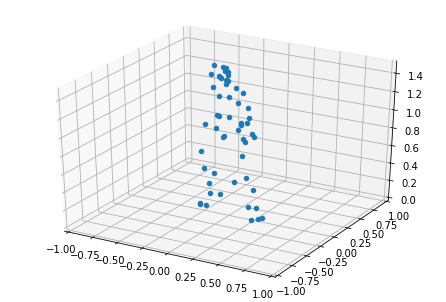

In [225]:
# pick out a short sequence following the first pose 
poses = df_tsne.loc[pose_index:pose_index+seq_length-1,column_names]
poses_np = poses.values
HTML(get_plot(poses_np, frames=len(poses_np), run_tests=False))

# UMAP

In [59]:
import umap
embedding = umap.UMAP().fit_transform(df.values)
embedding.shape

/project/hep/demers/mnp3/AI/dancing-with-robots/env/miniconda3/envs/aichoreo/lib/python3.6/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


(6649, 2)

Text(0, 0.5, 'UMAP-1')

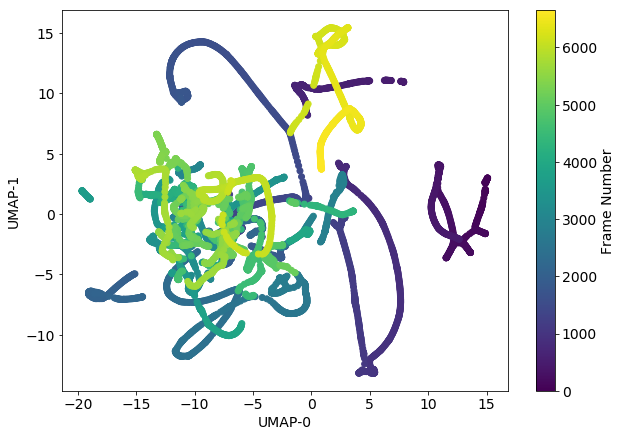

In [60]:
df['UMAP-0'] = embedding[:,0]
df['UMAP-1'] = embedding[:,1]

plt.scatter(df["UMAP-0"], df["UMAP-1"],c=np.arange(len(df)),cmap="viridis")
plt.colorbar(label="Frame Number")
plt.xlabel("UMAP-0")
plt.ylabel("UMAP-1")

Text(0, 0.5, 'UMAP-1')

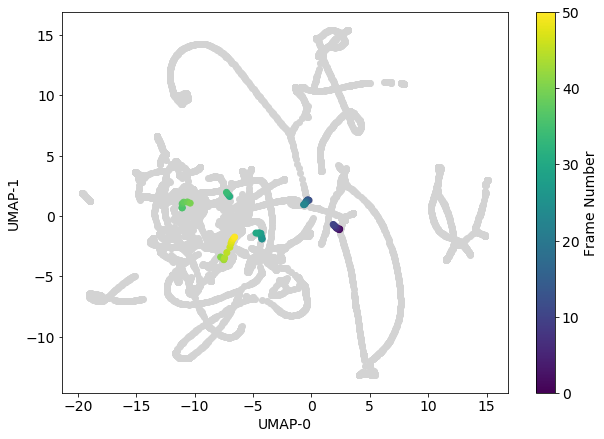

In [62]:
plt.scatter(df["UMAP-0"], df["UMAP-1"],color='lightgrey')
plt.scatter(df.loc[frame_start:frame_start+seq_length,"UMAP-0"], df.loc[frame_start:frame_start+seq_length,"UMAP-1"], c=np.arange(seq_length+1), cmap='viridis')
plt.colorbar(label="Frame Number")
plt.xlabel("UMAP-0")
plt.ylabel("UMAP-1")